In [37]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np
import cv2
from collections import Counter
from skimage.color import rgb2lab, deltaE_cie76
import os
import urllib
from skimage import io
import pdb

#*** added
from PIL import Image
import webcolors

#***
import pandas as pd
import seaborn as sns


#*** For prototype data extraction from excel - [maybe used for meta-data extraction]
import openpyxl
from openpyxl_image_loader import SheetImageLoader
# 
%matplotlib inline
%reload_ext autoreload
%autoreload 2

# Prototype only: Data Extraction from excel [maybe required for metadata]

In [10]:
# original
# image = io.imread('https://uploads3.wikiart.org/00123/images/charles-courtney-curran/in-the-luxembourg-garden-1889.jpg')
# #image = cv2.imread('https://uploads3.wikiart.org/00123/images/charles-courtney-curran/in-the-luxembourg-garden-1889.jpg')

# print("The type of this input is {}".format(type(image)))
# print("Shape: {}".format(image.shape))
# plt.imshow(image)

In [11]:
# original
# gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# plt.imshow(gray_image, cmap='gray')

In [5]:
#* extracting data as DF from excel. Needs pandas 

import pandas as pd
workbook = pd.read_excel("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Artplus_220808_List_of_Gallery_works_1.xlsx")
workbook.head()

,Record ID,Accession No.,Artist/Maker,Title,Image,Dating,Medium,Dimensions,Geo. Reference,Credit Line,Rights
0,100012362,2009-02997,Lim Cheng Hoe (1912–1979),Fishing Village at Kukup,NaN,1963,Watercolour on paper,Mount Measurement: 67.1 x 87.1 cm\nObject Dime...,Singapore,Collection of National Gallery Singapore,"CF - copyright documents received, full copyri..."
1,100012363,P-0927,Lim Cheng Hoe (1912–1979),Fort Canning Gateway,NaN,1959,Watercolour on paper,Object Dimensions: 31.0 x 40.0 cm,Singapore,Collection of National Gallery Singapore,"CF - copyright documents received, full copyri..."
2,100012364,P-0450,Lim Cheng Hoe (1912–1979),Singapore River,NaN,1962,Watercolour on paper,Object Dimensions: 37.8 x 50.5 cm,Singapore,Collection of National Gallery Singapore,"CF - copyright documents received, full copyri..."
3,100012365,P-0447,Lim Cheng Hoe (1912–1979),Portrait of T. Y. Choy,NaN,1965-1970,Watercolour on paper,Object Dimensions: 53.0 x 32.0 cm,Singapore,Gift of Michael Lim Hock Ann. Collection of Na...,"CF - copyright documents received, full copyri..."
4,100012366,2009-01799,Latiff Mohidin (1941–),Aku,NaN,1958,Oil on board,Frame measure: 43.0 x 33.0 x 2.5 cm\nObject Di...,Singapore,Collection of National Gallery Singapore,"CF - copyright documents received, full copyri..."


In [60]:
#* WORKING***
#* Sample code to extract column data from range of rows to save file name
def acc_id_t(num_rows):
    for i in range(num_rows):
        acc_id = workbook.loc[i,"Accession No."]
        path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/{acc_id}_t.jpg'
        print(path)

In [61]:
acc_id_t(3)

/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/2009-02997_t.jpg
/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/P-0927_t.jpg
/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/P-0450_t.jpg


In [62]:
#* WORKING: TO SPECIFY START AND END ROWS, but note start and end rows based on index, end index not inclusive***
#* Sample code to extract column data from range of rows to save file name
def acc_id_t(start_row, end_row):
    for i in range(start_row, end_row):
        acc_id = workbook.loc[i,"Accession No."]
        path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/{acc_id}_t.jpg'
        print(path)

In [64]:
acc_id_t(0,3)

/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/2009-02997_t.jpg
/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/P-0927_t.jpg
/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/P-0450_t.jpg


In [ ]:
#* Sample code to create path for image name extraction
# path = '/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/' # current directory
# filenames = [os.path.abspath(os.path.join(path, x)) for x in os.listdir(path) if '.jpg' in x]
# from matplotlib.image import imread
# images_df = pd.DataFrame([[imread(filename).flatten()] for filename in filenames], columns=['images'])
# images_df['id'] = filenames
# images_df['id'] = images_df['id'].apply(os.path.basename)

# images_df['id'] = images_df['id'].str.split('.').str[0]

In [8]:
# #* Base sample code to extract embedded images from excel, row specific. Needs openpyxl and openpyxl-image-loader 
# # import openpyxl
# # from openpyxl_image_loader import SheetImageLoader

# #loading the Excel File and the sheet
# pxl_doc = openpyxl.load_workbook("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Artplus_220808_List_of_Gallery_works.xlsx")
# sheet = pxl_doc['Sheet1']

# #calling the image_loader
# image_loader = SheetImageLoader(sheet)

# #get the image (put the cell you need instead of 'A1')
# image = image_loader.get('E322')

# #showing the image
# image.show()

# #saving the image
# acc_id = workbook["Accession No."]
# image.save("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/image_name.jpg")

In [158]:
# #* WORKING code to extract embedded images from excel loop by row, names file by acc_id. 
# # Needs openpyxl and openpyxl-image-loader 
# # import openpyxl
# # from openpyxl_image_loader import SheetImageLoader

# #loading the Excel File and the sheet
# pxl_doc = openpyxl.load_workbook("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Artplus_220808_List_of_Gallery_works.xlsx")
# sheet = pxl_doc['Sheet1']

# #calling the image_loader


# image_loader = SheetImageLoader(sheet)

# def save_image_t(num_rows):
       
#     for i in range(28,num_rows): #range start at 0 for row index refence

#         #get the image (put the cell you need instead of 'A1')
#         cell = f'E{i+2}' #add 1 to start at MS Excel Row 2 for pic extraction from row
        

#         image = image_loader.get(cell)

#         #showing the image
#         image.show()

#         #saving the image
#         acc_id = workbook.loc[i,"Accession No."] #workbook row index 0 equiv to MS Excel Row 2
#         path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/{acc_id}_t.jpg'
#         image.save(path)
#         print(f'{cell},{path}')


In [73]:
# #*** WORKING 2: code to extract embedded images from excel loop by row. 
# # Need pip install both openpyxl and openpyxl-image-loader 
# # import openpyxl
# # from openpyxl_image_loader import SheetImageLoader

# #loading the Excel File and the sheet
# pxl_doc = openpyxl.load_workbook("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Artplus_220808_List_of_Gallery_works_1.xlsx")
# sheet = pxl_doc['Sheet1']

# #calling the image_loader

# image_loader = SheetImageLoader(sheet)

# def save_image_t(num_rows):
       
#     for i in range(0,num_rows): #range start at 0 for row index refence

#         #get the image (put the cell you need instead of 'A1')
#         cell = f'E{i+2}' #add 1 to start at MS Excel Row 2 for pic extraction from row
        
#         if image_loader.image_in(cell):
#             image = image_loader.get(cell)
#             #image.show() #* To show image 

#             #saving the image
#             acc_id = workbook.loc[i,"Accession No."] #workbook row index 0 equiv to MS Excel Row 2
#             path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Thumbnails/Test10260/{acc_id}_t.jpg'
#             image.save(path)
#             path = 0
#             #print(f'{cell},{path}') #* To show Excel cell and save path and name
        


In [20]:
#*** WORKING 2: code to extract embedded images from excel loop by row. 
save_image_t(10260)

In [ ]:
for x in range(result[0], len(df)):
    row = df.loc[[x]]

In [74]:
# # original
# plt.imshow(image)

# Part 1: Image analysis - Get colors 

In [30]:
# modified_image = cv2.resize(image, (600, 400), interpolation = cv2.INTER_AREA)
# modified_image = modified_image.reshape(modified_image.shape[0]*modified_image.shape[1], 3)

In [83]:
#* TEST sample code using yellowbrick to generate optimal KMeans
# from sklearn.cluster import KMeans
# from sklearn.datasets import make_blobs

# from yellowbrick.cluster import KElbowVisualizer

# # Generate synthetic dataset with 8 random clusters
# X, y = make_blobs(n_samples=1000, n_features=12, centers=8, random_state=42)

# # Instantiate the clustering model and visualizer
# model = KMeans()
# visualizer = KElbowVisualizer(model, k=(4,12))

# visualizer.fit(X)        # Fit the data to the visualizer
# visualizer.show()        # Finalize and render the figure
# visualizer.elbow_value_ # Get elbow value

In [2]:
# visualizer.elbow_value_

7

In [3]:
def get_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [4]:
def RGB2HEX(color):
    return "#{:02x}{:02x}{:02x}".format(int(color[0]), int(color[1]), int(color[2]))

In [5]:
def get_colors(image, number_of_colors, show_chart):
    
    #modified_image = cv2.resize(image, (600, 400), interpolation = cv2.INTER_AREA)
    modified_image = image.reshape(image.shape[0]*image.shape[1], 3)
    
    clf = KMeans(n_clusters = number_of_colors)
    labels = clf.fit_predict(modified_image)
    
    counts = Counter(labels)
    # sort to ensure correct color percentage
    counts = dict(sorted(counts.items()))
    
    center_colors = clf.cluster_centers_
    # We get ordered colors by iterating through the keys
    ordered_colors = [center_colors[i] for i in counts.keys()]
    hex_colors = [RGB2HEX(ordered_colors[i]) for i in counts.keys()]
    #hex_colors = pd.DataFrame([RGB2HEX(ordered_colors[i]) for i in counts.keys()]).T
    #rgb_colors = [ordered_colors[i] for i in counts.keys()]

    if (show_chart):
        plt.figure(figsize = (8, 6))
        plt.pie(counts.values(), labels = hex_colors, colors = hex_colors)
    
    # return rgb_colors
    return hex_colors


In [64]:
# # original
# img = cv2.imread("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2011-00665.jpg")

# plt.imshow(img)
# # print("Filename : ",img.filename)

In [672]:
# original
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2011-00665.jpg"), 20, True)

In [673]:
# original
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2014-01426.jpg"), 2, True)

In [675]:
# original
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2014-01426.jpg"), 3, True)

In [676]:
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2014-01426.jpg"), 4, True)

In [677]:
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2014-01426.jpg"), 5, True)

In [678]:
#get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2011-00665.jpg"), 3, True)

['#16120c', '#4a3210', '#2a1e0f', '#8b652f']

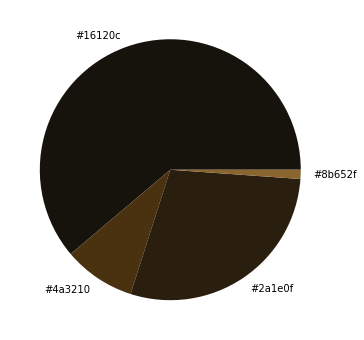

In [840]:
get_colors(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2011-00665.jpg"), 4, True)

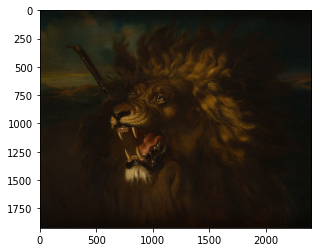

In [48]:
# original
plt.imshow(get_image("/Users/pl/code/paullsg/ART_API_Local/trial_images1/2011-00665.jpg"))

In [69]:
# # original
# img = cv2.imread("2011-01580.jpg")
# plt.imshow(img)

###TEST LOOP TO EXTRACT COLORS OF IMAGES IN LIBRARY

In [6]:
IMAGE_DIRECTORY = '/Users/pl/code/paullsg/ART_API_Local/trial_images1'
COLORS = {
    'GREEN': [0, 128, 0],
    'BLUE': [0, 0, 128],
    'YELLOW': [255, 255, 0],
    'RED': [255, 0, 0]
}
images = []
#pdb.set_trace()
for file in os.listdir(IMAGE_DIRECTORY):
#    images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
    if file.endswith('.jpg'):
        images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
        

In [805]:
print(len(images))
print(IMAGE_DIRECTORY)
#plt.imshow(images)

60
/Users/pl/code/paullsg/ART_API_Local/trial_images1


In [7]:
# WORKING Test loop function to extract colors based on input number of shades 
# from PIL import Image

def extract_image_colors(img, number_of_images, number_of_shades, show_image): #* chgd image to img, remove hardcode for theshold ann num of colors
    image_colors = get_colors(img, number_of_shades, False)  #chgd image to img
    #     extracted_colors = np.uint8(np.asarray([[]]))
    for i in range(number_of_shades):
        print(image_colors) ## change this to adding to list
        return image_colors

In [339]:
# # TEST trying to show_image and color after 
# # Test loop function to extract colors based on input number of shades 

# def extract_image_colors(img, number_of_images, number_of_shades, show_image): #* chgd image to img, remove hardcode for theshold ann num of colors
    
#     image_colors = get_colors(img, number_of_shades, False)  #chgd image to img
#     #     extracted_colors = np.uint8(np.asarray([[]]))
#     index = 1
#     for i in range(number_of_shades):
#         if show_image == True:
#             plt.figure(figsize = (10, 5))
#             plt.subplot(1, number_of_images,)
#             plt.imshow(img[i])  #chgd image to img
#         print(image_colors) ## change this to adding to list 
#         return image_colors
#         index +=1

In [8]:
# WORKING Test loop function to show number of images

# def show_numimages_numshades(img, number_of_images, number_of_shades): 
#     index = 1
    
#     for i in range(number_of_images):  #chgd image to img
#         extract_image_colors(img[i],  
#                             number_of_shades)
#         plt.subplot(1, number_of_images, index)
#         plt.imshow(img[i])  #chgd image to img
#         index += 1

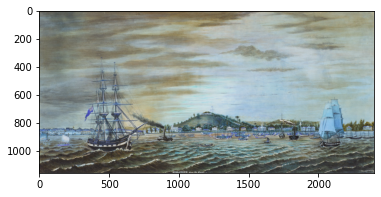

In [801]:
# # original
# img = cv2.imread("2011-01580.jpg")
# plt.imshow(img)

In [808]:
# Test only not used

# def show_filename(number_of_images):
#     os.listdir(IMAGE_DIRECTORY[i]):
#             if file.endswith('.jpg'):
#                 print(file)

#     for i in range(number_of_images):
#         os.listdir(IMAGE_DIRECTORY[i])
#         if file.endswith('.jpg'):
#             print(file)
#         return file

In [409]:
# # Test loop function to show number of images
# # Test filename addition in for loop

# def show_numimages_numshades(img, number_of_images, number_of_shades, show_image): 
#     index = 1
    
#     for i in range(number_of_images):  #chgd image to img
#         # show_filename(img[i])
#         extract_image_colors(img[i],
#                             number_of_images, 
#                             number_of_shades, 
#                             show_image)
#         if show_image == True:
#                 plt.figure(figsize = (10, 10))
#                 plt.subplot(1, number_of_images, index)
#                 plt.imshow(img[i])  #chgd image to img
#     index += 1

In [817]:
# #* Test return df 3/9/22 4pm

# def show_numimages_numshades(img, number_of_images, number_of_shades, show_image):
#     index = 1
#     dfList =pd.DataFrame([])
#     for i in range(number_of_images):  #chgd image to img
#         image_colors = extract_image_colors(img[i],
#                             number_of_images,
#                             number_of_shades,
#                             show_image
#                             )
#         dfList = pd.concat([dfList, image_colors])
#         #    images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
#         if show_image == True:
#             plt.figure(figsize = (10, 5))
#             plt.subplot(1, number_of_images, index)
#             plt.imshow(img[i])  #chgd image to img
#         index += 1
#         dfList.reset_index(drop=True, inplace=True)
        
#     return dfList

In [410]:
# img = images[:5]
# print(len(img))

In [827]:
# # test color extraction for a range of images
# %time
# # plt.figure(figsize = (10, 5))
# #Extract_image_color([image source],[number of images wanted],[number of shades wanted],[show image = True/False])
# show_numimages_numshades(images, 10, 5, True)
# %time

#Test extracting filename in loop

In [322]:
#from PIL import Image

In [18]:
# outfile = os.path.splitext(infile)[0] + ".jpg"

In [19]:
# import glob
# #glob.glob("/home/peter/pictures/*.png")
# #root_dir = ('/Users/plst/Desktop/LeWagon/dstools/trialdata')
# file_name =glob.glob('/Users/plst/Desktop/LeWagon/dstools/trialdata/*.jpg', recursive=True) # => ['2.txt', 'sub/3.txt']
# for f in file_name:
#     file_name = '"'+f+'"'
#     print (file_name)

 #Ref tests - Search images using colour

In [17]:
# !ls

In [679]:
# IMAGE_DIRECTORY = '/Users/pl/code/paullsg/ART_API_Local/trial_images1'
# COLORS = {
#     'GREEN': [0, 128, 0],
#     'BLUE': [0, 0, 128],
#     'YELLOW': [255, 255, 0],
#     'RED': [255, 0, 0]
# }
# images = []
# #pdb.set_trace()
# for file in os.listdir(IMAGE_DIRECTORY):
# #    images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
#     if file.endswith('.jpg'):
#         images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
#         #print (file)

In [39]:
print(len(images))
print(IMAGE_DIRECTORY)
#plt.imshow(images)

60
/Users/pl/code/paullsg/ART_API_Local/trial_images1


In [680]:
# plt.figure(figsize=(20, 10))
# for i in range(2):
# #for i in range(len(images)):
#     plt.subplot(1, len(images), i+1)
#     plt.imshow(images[i])

In [92]:
#* KEY: INPUT RANGE OF NUM OF IMAGES FOR RANGE HERE
img = images[:20]
print(len(img))

20


In [227]:
# plt.figure(figsize=(20, 10))
# for i in range(len(img)):
#     plt.subplot(5, len(img), i+1)
#     plt.imshow(img[i])

In [784]:
# ##*** WORKING Upload imagecolors CSV as DF original

# img_colors_df = pd.read_csv("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/df_10K.csv")
# first_column = img_colors_df.pop('id')
# img_colors_df.insert(0, 'id', first_column)
# img_colors_df = img_colors_df.drop(img_colors_df.columns[[1]], axis=1)
# img_colors_df.head()


## Image analysis : Using KMeans clustering to extract dominant colors 
#Use yellowbrick to generate optimal number of K 
#Optimal K used to generate DF of up to 6 optimal colors per image - output to CSV
#[chk Suzie code]

In [14]:
## [Image analysis done Suzie side - check code]
## Output uploaded here

##*** WORKING Upload imagecolors CSV as DF simplified

img_colors_df = pd.read_csv(("/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/df_10K.csv"),index_col=0)
# img_colors_df.head()

In [785]:
img_colors_df

,id,0,1,2,3,4,5
0,2012-00335_t,#c6b089,#6f6457,#dfc499,#9f8871,NaN,NaN
1,2010-01385_t,#656559,#d9bd3f,#383d37,#136949,#b0726b,NaN
2,2015-00358_t,#ebb87e,#534332,#c59962,#8d6e47,NaN,NaN
3,2002-00783_t,#aeafa7,#7f665e,#5c514e,#99887c,NaN,NaN
4,2016-00456_t,#3d3a36,#e3dbd0,#857e74,#c1b9ae,NaN,NaN
...,...,...,...,...,...,...,...
4374,2015-00249_t,#56645c,#afb9ab,#938e7d,#39332b,NaN,NaN
4375,2012-00261_t,#484a49,#f0ece3,#80807d,#bbbbb6,NaN,NaN
4376,2009-03342_t,#dcceb8,#9d917e,#baae99,#827668,NaN,NaN
4377,2010-04023_t,#201c20,#c0ab92,#8b7059,#ae9478,NaN,NaN


In [665]:
# for column in img_colors_df:
#     print(img_colors_df[column].values)

In [666]:
# for column in img_colors_df:
#     img_colors_df_copy = img_colors_df
#     img_colors_df_copy=img_colors_df_copy.drop(['id'], axis=1)


In [667]:
# img_colors_df_copy.head()

In [668]:
# img_colors_df_copy

In [506]:
# for row in img_colors_df_copy.itertuples():
#     #print(type(row))
#     print(row)

# Part 2: Image Search by color
- Define search parameters - 7 colors of rainbow
- User will pick search color, as input to be searched against the pre-generated DF of image colors
-[Search uses delta_CIE76 color difference to return colors within a specified threshold]
 

In [15]:
#* WORKING ORIGINAL REF: 
# Original def match_image_by_color(image, color, threshold = 60, number_of_colors = 10): 
#* This is for matching input to actual images live      
# def match_image_by_color(img, color, threshold, number_of_colors): # chgd image to img, remove hardcode for theshold ann num of colors
    
#     image_colors = get_colors(img, number_of_colors, False)  #chgd image to img
#     selected_color = rgb2lab(np.uint8(np.asarray([[color]])))

#     select_image = False
#     for i in range(number_of_colors):
#         curr_color = rgb2lab(np.uint8(np.asarray([[image_colors[i]]])))
#         print (f'curr_color = {curr_color}')
#         diff = deltaE_cie76(selected_color, curr_color)
#         print (f'diff = {diff}')
#         if (diff < threshold):
#             select_image = True
    
#     return select_image

In [75]:
#TEST call match_image for WORKING REF

# match_image_by_color(img, COLORS['GREEN'], 60, 6)

In [24]:
#*** RAINBOW COLOR DICTIONARY REFERENCE

COLORS = {
    'VIOLET': [148, 0, 211], #Hex #9400D3
    'INDIGO': [75, 0, 130], #Hex #4B0082
    'BLUE': [0, 0, 255],  # Hex #0000FF THRESHOLD [70?]
    'GREEN': [0, 128, 0], # Hex #008000, THRESHOLD [65]
    'YELLOW': [255, 255, 0], # Hex #FFFF00
    'ORANGE': [255, 127, 0], # Hex #FF7F00
    'RED': [255, 0, 0] # Hex #FF0000, THRESHOLD [70]
}

In [43]:
#*** WORKING function to convert hex to RGB: webcolors
# then RGB to lab
# >>> hex_to_rgb('#000080')
# (0, 0, 128)
# >>> rgb_to_hex((255, 255, 255))
# '#ffffff'
#  pip install webcolors

import webcolors

def hex2lab(column_hexcolor):
    column_RGBcolor = webcolors.hex_to_rgb(column_hexcolor)
    #print(column_RGBcolor)
    # column_LABcolor = rgb2lab(np.uint8(np.asarray([[image_colors[i]]])))
    column_LABcolor = rgb2lab(np.uint8(np.asarray([[column_RGBcolor]])))
    #print(column_LABcolor)
    return column_LABcolor

In [479]:
# #* TEST function to retrieve pre-clustered colors of each image by column

# # #* COLUMN COLOR EXTRACTION CODE HERE
# # def get_color_by_column(img_color_column_num):

# def get_color_by_column(img_color_column_num): 
#     for column in img_colors_df_copy:
#         for values in img_colors_df_copy[column].values:
#             if str(values).startswith('#'):
#                 print(values)
# #                 return(values)

In [ ]:
#* prev alt
#     img_colors_dict = img_colors_df.to_dict('records')

#     for entry in img_colors_dict:
#     values = [v for k,v in entry.items() if k != 'id']
#     # print(values)

#     for i in values:
#     print [i]
#     hex2lab = hex2lab([i])
#     print(hex_to_rgb)

In [444]:
#*TEST call for get_color_by_column
# get_color_by_column(6)

In [502]:
# # Test 1
# # WIP returns values of whole rows and repeats, to fix loop??

# #* TEST pseudo-code where input color is matched against the color DF already generated 
# #* >>> Change code to see if possible to match colors

# def match_image_by_color(color, threshold, img_color_column_num): #remove img as input is df
    
#     #* Selected_color_ is user's chosen color for search
#     selected_color_name = color
#     print(f'selected_color_name = {selected_color_name}')

#     selected_color_lab = rgb2lab(np.uint8(np.asarray([[color]]))) #* input color by user
#     print(f'selected_color_lab= {selected_color_lab}')
    
#     #orig: image_colors = get_colors(img, number_of_colors, False)  #reference color >>> chg to 
#     #* to write get_color_by_column >> go to dataframe check row
#     # image_colors = get_color_by_column(img_color_column_num) # colors of image (from DF) to br checked against by row 
   
#     #iterate over rows in img_color_df:
#     for row in img_colors_df_copy:
#         print(f'row num = {row}')
#         select_image_id = False
        
#         for i in range(img_color_column_num): #loop thru each color column for each image 
#             #orig: curr_color = rgb2lab(np.uint8(np.asarray([[image_colors[i]]])))
            
#             # Call get_color_by_column to get each column in row
#             column_hexcolor = get_color_by_column(img_color_column_num)
#             print(f'column_num = {i}')
#             print(f'column_hexcolor = {column_hexcolor}')
                       
#             if str(column_hexcolor).startswith('#'):
#                 column_LABcolor = hex2lab(column_hexcolor) #calling hex2lab 
#                 print(f'column_LABcolor = {column_LABcolor}')

#                 diff = deltaE_cie76(selected_color_lab, column_LABcolor)
#                 print(f'diff= {diff}')

#                 if (diff < threshold):
#                     select_image_id = True
#                 print(select_image_id)
#                 return select_image_id

In [579]:
# #TEST call match_image for Test 1

# match_image_by_color(COLORS['BLUE'], 65, 6)

In [500]:
# #* TEST 2 WIP
# #* incorporate column loop direct 
# #* >>> Change code to see if possible to match colors

# def match_image_by_color(color, threshold, img_color_column_num): #remove img as input is df
    
#     #* Selected_color_ is user's chosen color for search
#     selected_color_name = color
#     print(f'selected_color_name = {selected_color_name}')

#     selected_color_lab = rgb2lab(np.uint8(np.asarray([[color]]))) #* input color by user
#     print(f'selected_color_lab= {selected_color_lab}')
    
#     #orig: image_colors = get_colors(img, number_of_colors, False)  #reference color >>> chg to 
#     #* to write get_color_by_column >> go to dataframe check row
#     # image_colors = get_color_by_column(img_color_column_num) # colors of image (from DF) to br checked against by row 
   
#     #iterate over rows in img_color_df:
#     for row in img_colors_df_copy:
#         print(f'row num = {row}')
        
#         select_image_id = False
        
# #         for i in range(img_color_column_num): #loop thru each color column for each image 
#             #orig: curr_color = rgb2lab(np.uint8(np.asarray([[image_colors[i]]])))
            
#             # Call get_color_by_column to get each column in row
           
#         for column in img_colors_df_copy:
#             print(f'column_num = {column}')

#             for values in img_colors_df_copy[column].values:
#                 #test_5[dataFrame['column name'].str.match('#')]
#                 if str(values).startswith('#'):
#                     column_hexcolor = values
#                     print(f'column_hexcolor = {column_hexcolor}')

#                     if str(column_hexcolor).startswith('#'):
#                         column_LABcolor = hex2lab(column_hexcolor) #calling hex2lab 
#                         print(f'column_LABcolor = {column_LABcolor}')

#                         diff = deltaE_cie76(selected_color_lab, column_LABcolor)
#                         print(f'diff= {diff}')

#                         if (diff < threshold):
#                             select_image_id = True
#                 print(select_image_id)
#                 return select_image_id

In [ ]:
# #TEST call match_image for Test 2

# match_image_by_color(COLORS['BLUE'], 65, 6)

In [29]:
#*** WORKING *** TEST 3 - with PRINTS

#* incorporate column loop direct - reduce loops 

# importing Image class from PIL package
from PIL import Image

def match_image_by_color(color, threshold, rows_to_chk, columns_to_chk): #remove img as input is df
    
    #* Selected_color_ is user's chosen color for search
    selected_color_name = color
    print(f'selected_color_name = {selected_color_name}')

    selected_color_lab = rgb2lab(np.uint8(np.asarray([[color]]))) #* input color by user
    print(f'selected_color_lab= {selected_color_lab}\n')
       
    #iterate over rows in img_color_df:
    for row in range(rows_to_chk):
        print(f'\nRow_num = {row}')
        
        row_img_shown = False  #denotes whether row image shown b4. reset to false for each new row.
        
        for column in range(columns_to_chk):
            print(f'\nRow, Column_num = {row},{column}')
            
            column_hexcolor = img_colors_df.loc[row][column+1]  #*use column+1 to skip ID column  
            print(f'Column_hexcolor = {column_hexcolor}')
            
            select_image_id = False
            
            if str(column_hexcolor).startswith('#'):
                column_LABcolor = hex2lab(column_hexcolor) #calling hex2lab 
                print(f'Column_LABcolor = {column_LABcolor}')

                diff = deltaE_cie76(selected_color_lab, column_LABcolor)
                print(f'Delta Diff= {diff}')
                
                if (diff < threshold):
                    select_image_id = True
                    print(f'\nrow_img_shown = {row_img_shown}')
                    
                    image_id = img_colors_df.loc[row][0]
                    print(f'\nimage_id = {image_id}')
                    
                    if row_img_shown == False:
                        
                        #Show the image
                        image_path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Thumbnails/Test10260_4379/{image_id}.jpg'

                        # creating a object
                        try:
                            im = Image.open(image_path)
                        except: 
                            pass
                        display(im)
                        row_img_shown = True #once row img shown at least once b4 no need to show again.
                        
                print(f'select_image = {select_image_id}')
                

                #return select_image_id

In [139]:
#*** WORKING *** TEST 3 (NO PRINTS)
#* incorporate column loop direct - reduce loops 

# importing Image class from PIL package
from PIL import Image

def match_image_by_color(color, threshold, rows_to_chk, columns_to_chk): #remove img as input is df

    image_ret_count = 0
     
    #* Selected_color_ is user's chosen color for search
    selected_color_name = color
    print(f'selected_color_name = {selected_color_name}')
    
    selected_color_lab = rgb2lab(np.uint8(np.asarray([[color]]))) #* input color by user
    #print(f'selected_color_lab= {selected_color_lab}\n')
       
    #iterate over rows in img_color_df:
    for row in range(rows_to_chk):
        #print(f'\nRow_num = {row}') 
        
        row_img_shown = False  #denotes whether row image shown b4. reset to false for each new row.
        
        for column in range(columns_to_chk):
            #print(f'\nRow, Column_num = {row},{column}') #*print here to check if looping accross rows
            
            column_hexcolor = img_colors_df.loc[row][column+1]  #*use column+1 to skip ID column  
            #print(f'Column_hexcolor = {column_hexcolor}')
            
            select_image_id = False
            
            if str(column_hexcolor).startswith('#'): #to skip NaNs or non-hex columns
                column_LABcolor = hex2lab(column_hexcolor) #calling hex2lab 
                #print(f'Column_LABcolor = {column_LABcolor}')

                diff = deltaE_cie76(selected_color_lab, column_LABcolor)
                #print(f'Delta Diff= {diff}') #print Diff here to show for all rows even if not selected
                
                if (diff < threshold):
                    select_image_id = True
                    #print(f'\nrow_img_shown = {row_img_shown}')
                    
                    if row_img_shown == False:
                        
                        image_id = img_colors_df.loc[row][0]
                        print(f'\nimage_id = {image_id}') #no space line after image ID
                        
                        image_ret_count += 1
                        
                        #Show the image
                        image_path = f'/Users/pl/code/paullsg/ART_API_Local/Artplus_220808_List/Thumbnails/Test10260_4379/{image_id}.jpg'

                        # creating a object
                        try:
                            im = Image.open(image_path)
                            print(f'Row, Column_num = {row},{column}') #*print here to show Row, Column of selected image    
                            print(f'Delta Diff= {diff}') #*print Diff here to show for selected rows only one
                            
                        except: 
                            pass
                        display(im)
                        row_img_shown = True #once row img shown at least once b4 no need to show again.
                
                        print(f'img_ret_number = {image_ret_count}')
        
                #print(f'select_image = {select_image_id}')
                
    if image_ret_count != 0:         
        print(f'\nTotal matching images = {image_ret_count}')

                #NOT used? return select_image_id

In [140]:
# #* RESHOW: RAINBOW COLOR DICTIONARY REFERENCE

# COLORS = {
#     'VIOLET': [148, 0, 211], #Hex #9400D3
#     'INDIGO': [75, 0, 130], #Hex #4B0082
#     'BLUE': [0, 0, 255],  # Hex #0000FF THRESHOLD [70?]
#     'GREEN': [0, 128, 0], # Hex #008000, THRESHOLD [65]
#     'YELLOW': [255, 255, 0], # Hex #FFFF00
#     'ORANGE': [255, 127, 0], # Hex #FF7F00
#     'RED': [255, 0, 0] # Hex #FF0000
# }

selected_color_name = [255, 0, 0]

image_id = 2017-01051_t
Row, Column_num = 11,0
Delta Diff= [[66.93225227]]


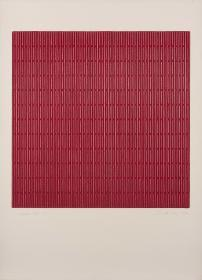

img_ret_number = 1

image_id = GI-0134-(PC)_t
Row, Column_num = 49,2
Delta Diff= [[59.10990147]]


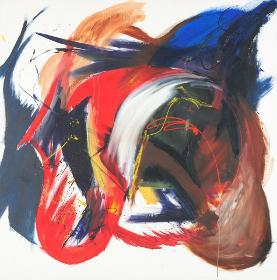

img_ret_number = 2

image_id = P-0083_t
Row, Column_num = 78,0
Delta Diff= [[69.36623466]]


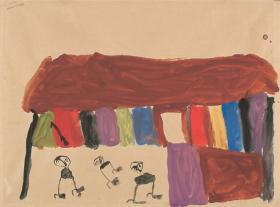

img_ret_number = 3

image_id = 2012-00724_t
Row, Column_num = 104,1
Delta Diff= [[45.37617984]]


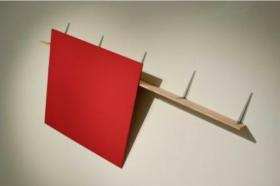

img_ret_number = 4

image_id = 2012-00761_t
Row, Column_num = 107,1
Delta Diff= [[45.0348382]]


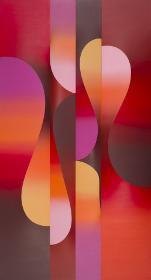

img_ret_number = 5

image_id = GI-0044_t
Row, Column_num = 131,0
Delta Diff= [[64.15627108]]


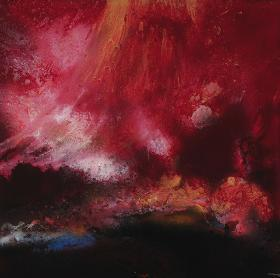

img_ret_number = 6

image_id = GI-0769_t
Row, Column_num = 141,0
Delta Diff= [[60.52308786]]


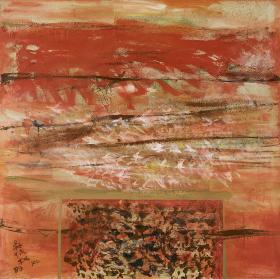

img_ret_number = 7

image_id = P-1203_t
Row, Column_num = 168,0
Delta Diff= [[61.12471078]]


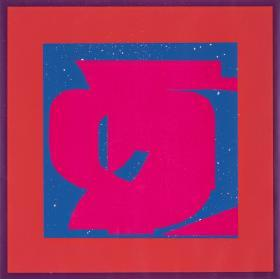

img_ret_number = 8

image_id = 1996-00542_t
Row, Column_num = 170,1
Delta Diff= [[62.36772887]]


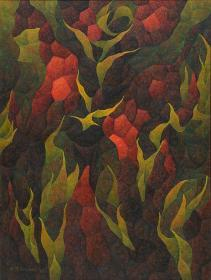

img_ret_number = 9

image_id = 2009-01510_t
Row, Column_num = 180,0
Delta Diff= [[68.49619257]]


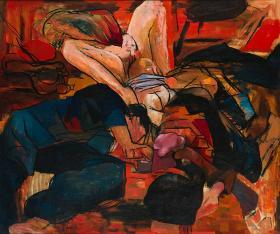

img_ret_number = 10

image_id = P-1147_t
Row, Column_num = 189,3
Delta Diff= [[59.04244322]]


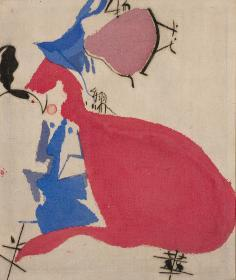

img_ret_number = 11

image_id = 2015-00261_t
Row, Column_num = 243,3
Delta Diff= [[67.43208316]]


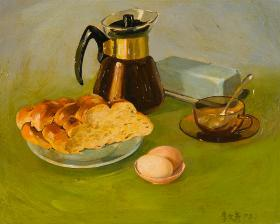

img_ret_number = 12

image_id = 2010-03391_t
Row, Column_num = 288,0
Delta Diff= [[64.40806373]]


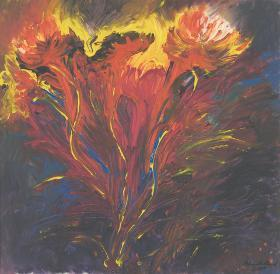

img_ret_number = 13

image_id = GI-0756_t
Row, Column_num = 308,3
Delta Diff= [[60.02607936]]


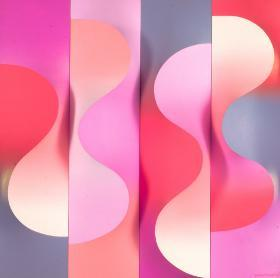

img_ret_number = 14

image_id = 2011-00679_t
Row, Column_num = 352,1
Delta Diff= [[68.10546514]]


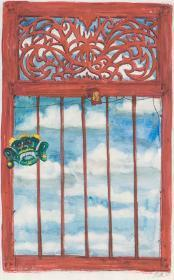

img_ret_number = 15

image_id = P-0906_t
Row, Column_num = 377,3
Delta Diff= [[67.90405182]]


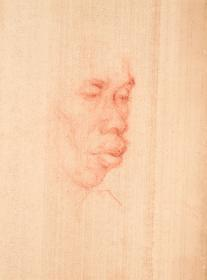

img_ret_number = 16

image_id = P-0201_t
Row, Column_num = 393,2
Delta Diff= [[64.82839214]]


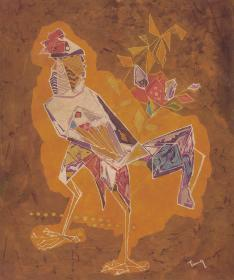

img_ret_number = 17

image_id = P-0244_t
Row, Column_num = 394,0
Delta Diff= [[56.67519587]]


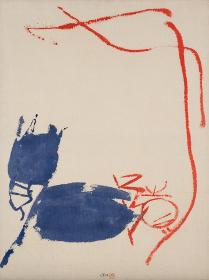

img_ret_number = 18

image_id = P-0225_t
Row, Column_num = 457,1
Delta Diff= [[66.13172208]]


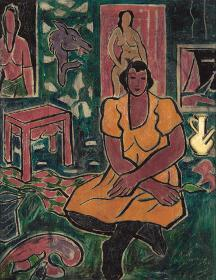

img_ret_number = 19

image_id = P-0124_t
Row, Column_num = 469,2
Delta Diff= [[54.89430458]]


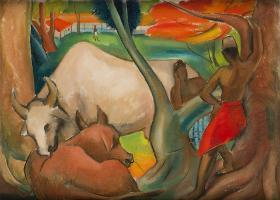

img_ret_number = 20

image_id = GI-0125-(PC)_t
Row, Column_num = 488,3
Delta Diff= [[55.86340888]]


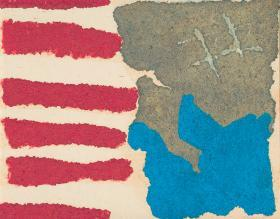

img_ret_number = 21

image_id = 2003-04131_t
Row, Column_num = 496,0
Delta Diff= [[44.43651591]]


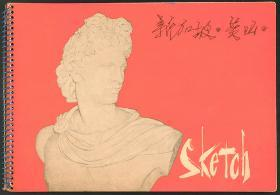

img_ret_number = 22

image_id = 2018-01076_t
Row, Column_num = 541,1
Delta Diff= [[69.36516473]]


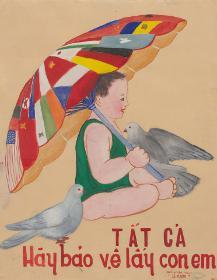

img_ret_number = 23

image_id = 2012-00722_t
Row, Column_num = 563,1
Delta Diff= [[62.99440724]]


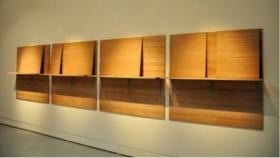

img_ret_number = 24

image_id = GI-0037-(OT)_t
Row, Column_num = 653,3
Delta Diff= [[64.85828633]]


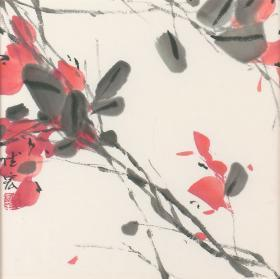

img_ret_number = 25

image_id = 1993-01394_t
Row, Column_num = 719,0
Delta Diff= [[63.14795388]]


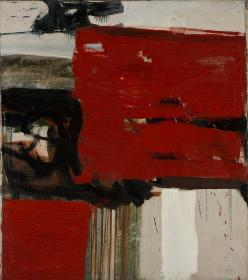

img_ret_number = 26

image_id = 2015-00412_t
Row, Column_num = 780,1
Delta Diff= [[42.97030233]]


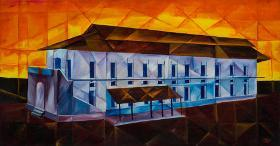

img_ret_number = 27

image_id = P-0104_t
Row, Column_num = 806,1
Delta Diff= [[51.52358831]]


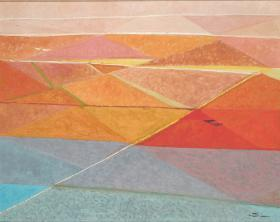

img_ret_number = 28

image_id = GI-0561-(OT)_t
Row, Column_num = 842,1
Delta Diff= [[69.16916565]]


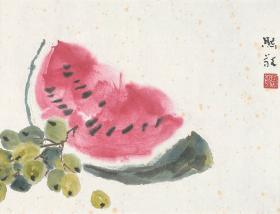

img_ret_number = 29

image_id = 2003-03012_t
Row, Column_num = 851,2
Delta Diff= [[63.95393329]]


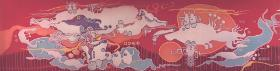

img_ret_number = 30

image_id = P-1143_t
Row, Column_num = 855,1
Delta Diff= [[44.02709561]]


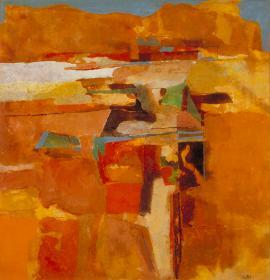

img_ret_number = 31

image_id = 2016-00476_t
Row, Column_num = 961,3
Delta Diff= [[64.72368554]]


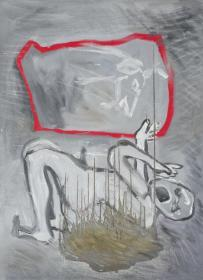

img_ret_number = 32

image_id = 1991-00283_t
Row, Column_num = 976,2
Delta Diff= [[68.92993999]]


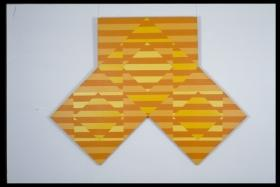

img_ret_number = 33

image_id = P-0804_t
Row, Column_num = 999,3
Delta Diff= [[69.03800334]]


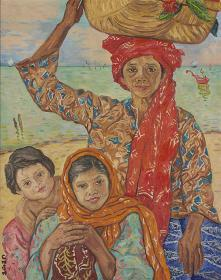

img_ret_number = 34

image_id = 2017-00479_t
Row, Column_num = 1025,3
Delta Diff= [[69.17782168]]


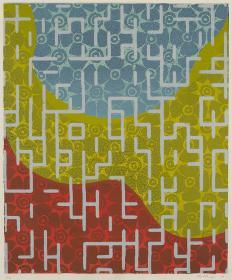

img_ret_number = 35

image_id = 2017-00816_t
Row, Column_num = 1040,0
Delta Diff= [[37.18229246]]


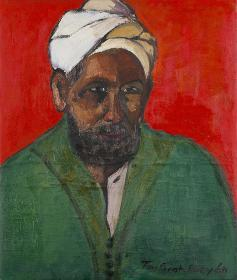

img_ret_number = 36

image_id = 1999-01033_t
Row, Column_num = 1048,0
Delta Diff= [[46.84882671]]


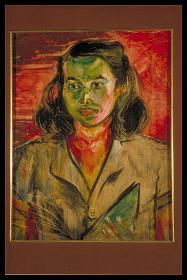

img_ret_number = 37

image_id = 2017-00231_t
Row, Column_num = 1089,3
Delta Diff= [[63.4139385]]


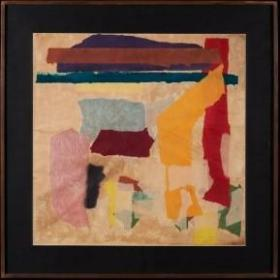

img_ret_number = 38

image_id = 1994-05397_t
Row, Column_num = 1137,1
Delta Diff= [[65.14069764]]


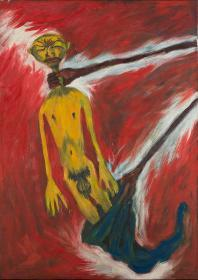

img_ret_number = 39

image_id = 2016-00324_t
Row, Column_num = 1141,1
Delta Diff= [[67.29750211]]


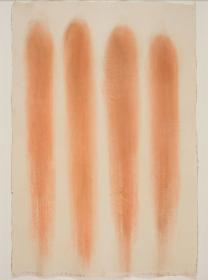

img_ret_number = 40

image_id = 1997-03445_t
Row, Column_num = 1151,0
Delta Diff= [[61.07531127]]


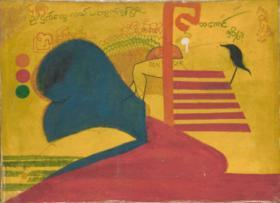

img_ret_number = 41

image_id = 2018-00442_t
Row, Column_num = 1164,1
Delta Diff= [[57.12966732]]


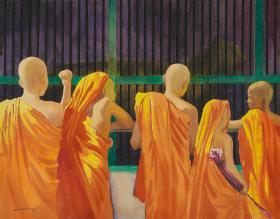

img_ret_number = 42

image_id = 2011-00678_t
Row, Column_num = 1167,2
Delta Diff= [[67.98051057]]


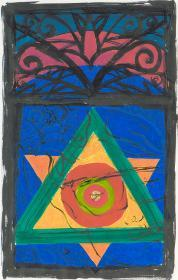

img_ret_number = 43

image_id = 2005-00470_t
Row, Column_num = 1226,1
Delta Diff= [[65.00483241]]


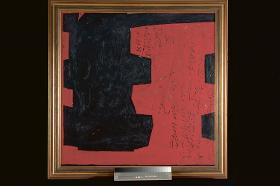

img_ret_number = 44

image_id = 1991-00279_t
Row, Column_num = 1236,0
Delta Diff= [[47.24046874]]


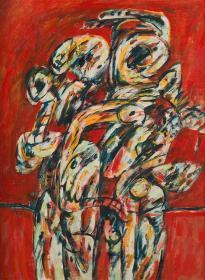

img_ret_number = 45

image_id = 2007-53418_t
Row, Column_num = 1287,1
Delta Diff= [[68.24927643]]


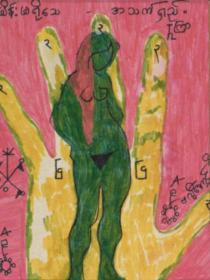

img_ret_number = 46

image_id = P-1160_t
Row, Column_num = 1342,2
Delta Diff= [[69.82608443]]


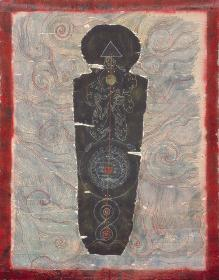

img_ret_number = 47

image_id = GI-0483-(PC)_t
Row, Column_num = 1360,0
Delta Diff= [[69.51081704]]


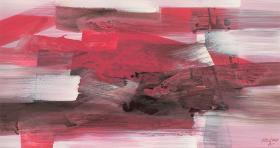

img_ret_number = 48

image_id = P-0353-A_t
Row, Column_num = 1369,0
Delta Diff= [[49.17471048]]


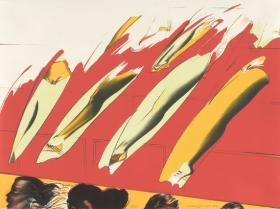

img_ret_number = 49

image_id = GI-0551-(OT)_t
Row, Column_num = 1426,2
Delta Diff= [[61.82630952]]


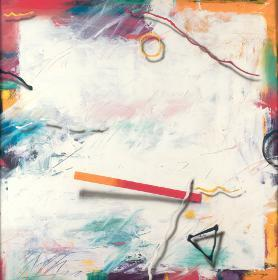

img_ret_number = 50

image_id = 2018-01075_t
Row, Column_num = 1467,3
Delta Diff= [[66.61153616]]


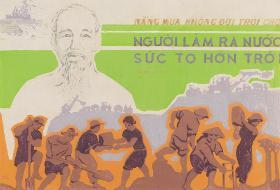

img_ret_number = 51

image_id = 2002-00782_t
Row, Column_num = 1495,0
Delta Diff= [[69.0828814]]


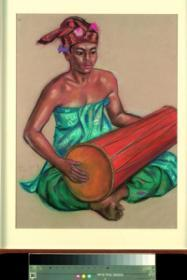

img_ret_number = 52

image_id = GI-0051-(PC)_t
Row, Column_num = 1508,3
Delta Diff= [[54.02556782]]


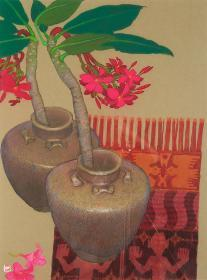

img_ret_number = 53

image_id = 2014-00523_t
Row, Column_num = 1535,2
Delta Diff= [[69.8948454]]


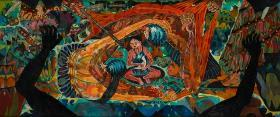

img_ret_number = 54

image_id = 2018-00051_t
Row, Column_num = 1548,1
Delta Diff= [[68.15048426]]


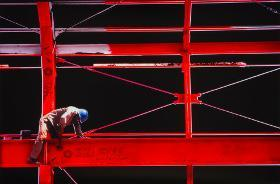

img_ret_number = 55

image_id = 2017-00074_t
Row, Column_num = 1577,1
Delta Diff= [[69.7513149]]


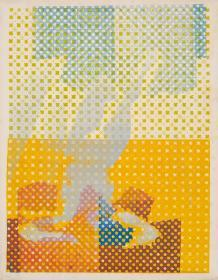

img_ret_number = 56

image_id = P-0905_t
Row, Column_num = 1621,1
Delta Diff= [[67.45153133]]


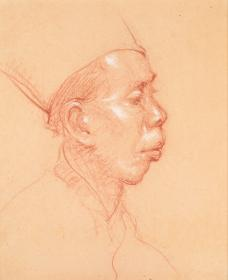

img_ret_number = 57

image_id = P-0266-C_t
Row, Column_num = 1631,0
Delta Diff= [[51.52295561]]


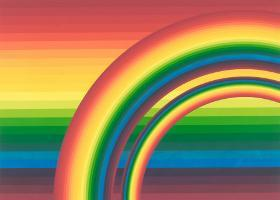

img_ret_number = 58

image_id = 2020-00348_t
Row, Column_num = 1655,1
Delta Diff= [[61.62724188]]


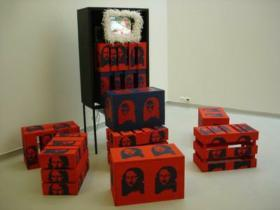

img_ret_number = 59

image_id = 1996-00915_t
Row, Column_num = 1685,1
Delta Diff= [[45.66085674]]


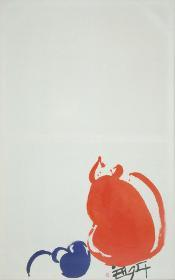

img_ret_number = 60

image_id = 1997-03483_t
Row, Column_num = 1696,3
Delta Diff= [[43.36128402]]


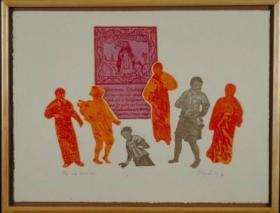

img_ret_number = 61

image_id = P-0326_t
Row, Column_num = 1722,0
Delta Diff= [[38.86308335]]


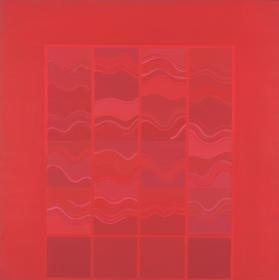

img_ret_number = 62

image_id = GI-0081_t
Row, Column_num = 1725,3
Delta Diff= [[65.2989564]]


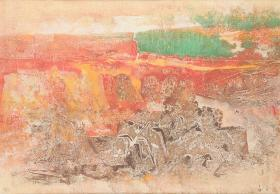

img_ret_number = 63

image_id = 2010-01284_t
Row, Column_num = 1741,2
Delta Diff= [[51.75806664]]


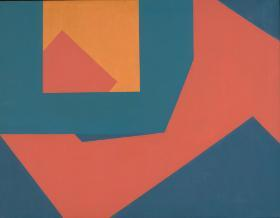

img_ret_number = 64

image_id = P-0086_t
Row, Column_num = 1824,2
Delta Diff= [[45.93687908]]


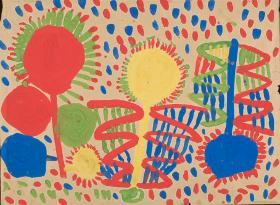

img_ret_number = 65

image_id = 2020-00351_t
Row, Column_num = 1835,3
Delta Diff= [[67.39182752]]


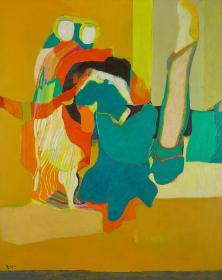

img_ret_number = 66

image_id = P-0925_t
Row, Column_num = 1843,0
Delta Diff= [[65.25007629]]


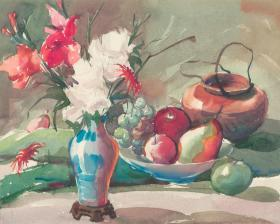

img_ret_number = 67

image_id = 2021-00003_t
Row, Column_num = 1882,1
Delta Diff= [[69.75118858]]


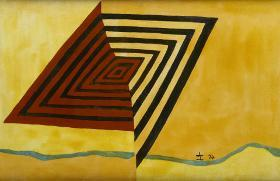

img_ret_number = 68

image_id = 2003-04136_t
Row, Column_num = 1888,3
Delta Diff= [[66.5194988]]


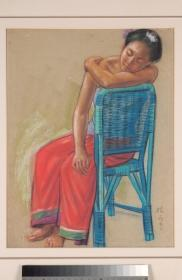

img_ret_number = 69

image_id = GI-0702-(OT)_t
Row, Column_num = 1897,0
Delta Diff= [[50.43114381]]


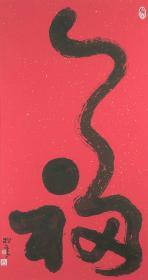

img_ret_number = 70

image_id = 2013-00206_t
Row, Column_num = 1914,0
Delta Diff= [[41.0593563]]


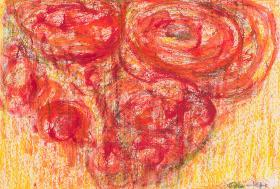

img_ret_number = 71

image_id = GI-0616-(OT)_t
Row, Column_num = 1917,3
Delta Diff= [[60.28476427]]


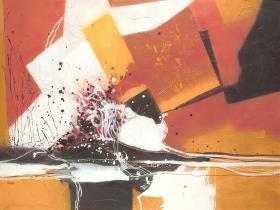

img_ret_number = 72

image_id = 2015-00437_t
Row, Column_num = 1923,2
Delta Diff= [[67.62571554]]


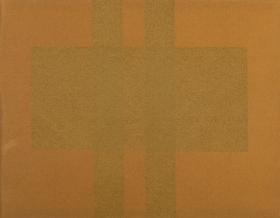

img_ret_number = 73

image_id = 2015-00517_t
Row, Column_num = 1998,3
Delta Diff= [[53.90814227]]


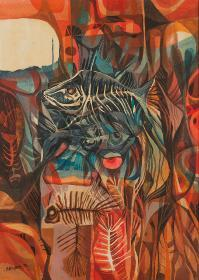

img_ret_number = 74

image_id = P-0410_t
Row, Column_num = 2000,1
Delta Diff= [[51.26828475]]


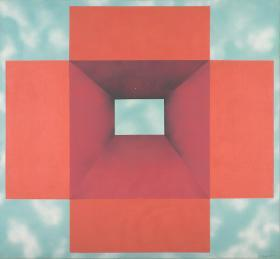

img_ret_number = 75

image_id = 1999-00294_t
Row, Column_num = 2002,1
Delta Diff= [[53.33222761]]


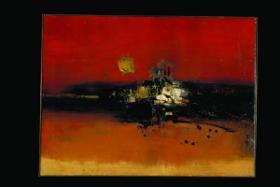

img_ret_number = 76

image_id = 2001-03379_t
Row, Column_num = 2029,4
Delta Diff= [[66.19418562]]


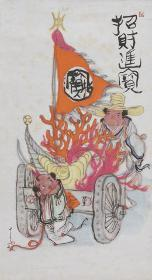

img_ret_number = 77

image_id = P-0649_t
Row, Column_num = 2030,1
Delta Diff= [[67.42561809]]


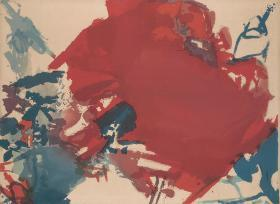

img_ret_number = 78

image_id = P-1298_t
Row, Column_num = 2036,1
Delta Diff= [[63.13742762]]


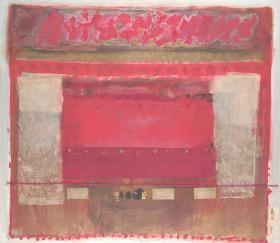

img_ret_number = 79

image_id = 2018-01116_t
Row, Column_num = 2043,2
Delta Diff= [[64.60394948]]


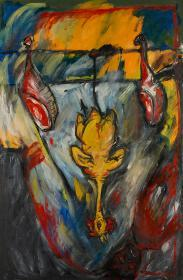

img_ret_number = 80

image_id = 2015-00327_t
Row, Column_num = 2053,0
Delta Diff= [[69.62013482]]


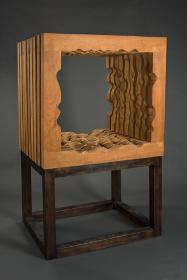

img_ret_number = 81

image_id = P-1220_t
Row, Column_num = 2056,3
Delta Diff= [[67.20038643]]


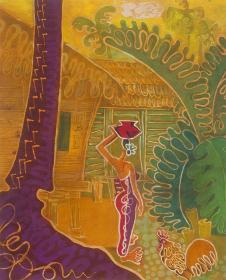

img_ret_number = 82

image_id = Pending_Acquisition_Resource_Centre_t


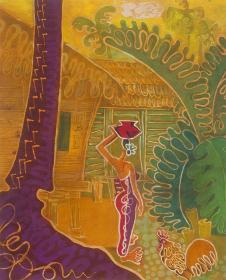

img_ret_number = 83

image_id = P-0946_t
Row, Column_num = 2130,3
Delta Diff= [[62.43717129]]


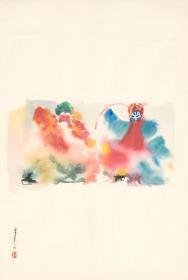

img_ret_number = 84

image_id = 2014-01440_t
Row, Column_num = 2134,0
Delta Diff= [[68.94332505]]


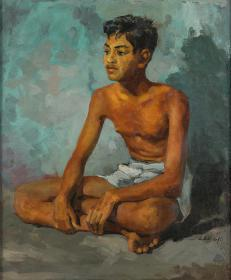

img_ret_number = 85

image_id = 2019-00504_t
Row, Column_num = 2204,1
Delta Diff= [[53.77920409]]


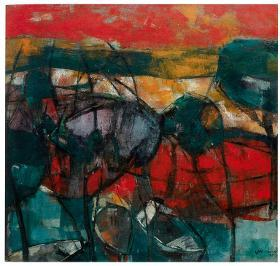

img_ret_number = 86

image_id = GI-0036-(OT)_t
Row, Column_num = 2218,3
Delta Diff= [[65.23704946]]


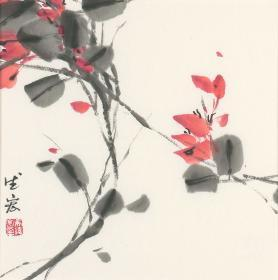

img_ret_number = 87

image_id = P-0235_t
Row, Column_num = 2231,2
Delta Diff= [[27.33728165]]


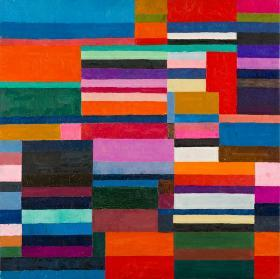

img_ret_number = 88

image_id = GI-0701-(OT)_t
Row, Column_num = 2241,3
Delta Diff= [[62.83637524]]


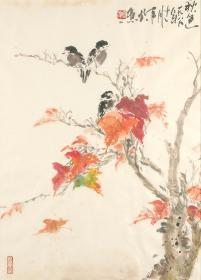

img_ret_number = 89

image_id = 2010-04768_t
Row, Column_num = 2242,3
Delta Diff= [[64.89553038]]


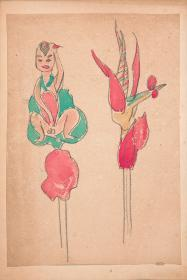

img_ret_number = 90

image_id = 2004-00536_t
Row, Column_num = 2281,2
Delta Diff= [[64.44510071]]


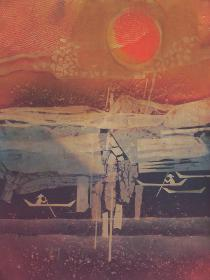

img_ret_number = 91

image_id = 2015-00422_t
Row, Column_num = 2317,1
Delta Diff= [[68.68874049]]


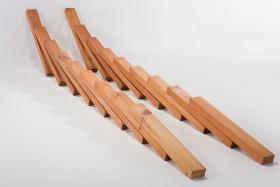

img_ret_number = 92

image_id = 2016-00394_t
Row, Column_num = 2340,0
Delta Diff= [[44.89611146]]


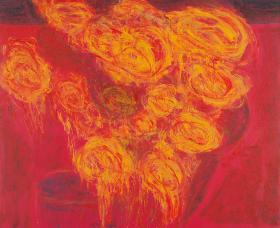

img_ret_number = 93

image_id = GI-0416-(OT)_t
Row, Column_num = 2358,2
Delta Diff= [[48.20537846]]


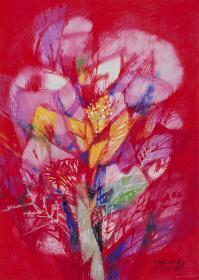

img_ret_number = 94

image_id = 2014-01345_t
Row, Column_num = 2378,1
Delta Diff= [[57.55307208]]


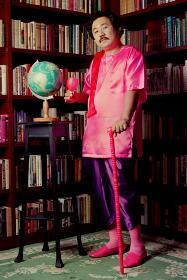

img_ret_number = 95

image_id = 2017-00861_t
Row, Column_num = 2412,1
Delta Diff= [[56.4479618]]


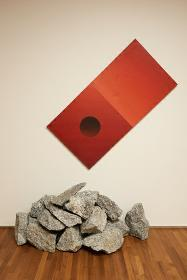

img_ret_number = 96

image_id = P-1211_t
Row, Column_num = 2417,0
Delta Diff= [[66.23427455]]


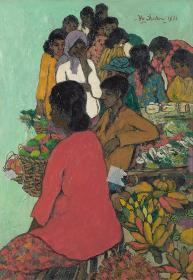

img_ret_number = 97

image_id = 2018-00921_t
Row, Column_num = 2442,1
Delta Diff= [[59.54317792]]


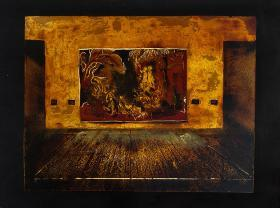

img_ret_number = 98

image_id = 1997-02963_t
Row, Column_num = 2446,0
Delta Diff= [[69.52209864]]


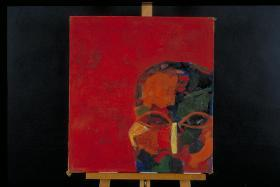

img_ret_number = 99

image_id = GI-0780-(OT)_t
Row, Column_num = 2458,1
Delta Diff= [[69.24657637]]


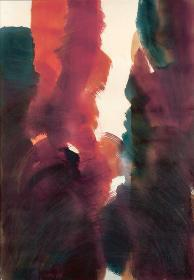

img_ret_number = 100

image_id = P-1112_t
Row, Column_num = 2502,0
Delta Diff= [[57.41515759]]


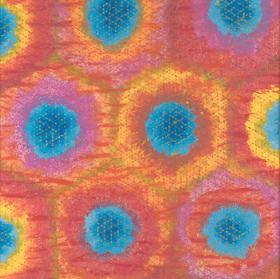

img_ret_number = 101

image_id = P-0077_t
Row, Column_num = 2565,0
Delta Diff= [[55.09938757]]


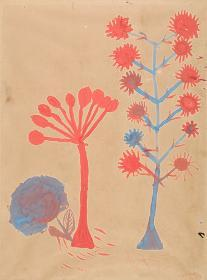

img_ret_number = 102

image_id = ASB-0006_t
Row, Column_num = 2610,2
Delta Diff= [[52.50397764]]


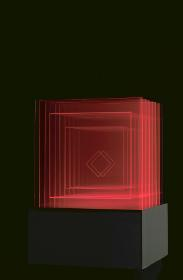

img_ret_number = 103

image_id = 2020-00264_t
Row, Column_num = 2619,3
Delta Diff= [[58.00633043]]


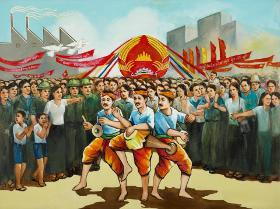

img_ret_number = 104

image_id = 1994-04139_t
Row, Column_num = 2621,0
Delta Diff= [[69.79906746]]


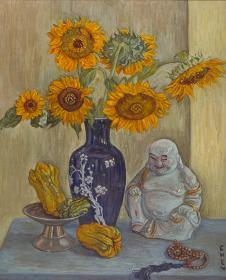

img_ret_number = 105

image_id = P-0975_t
Row, Column_num = 2692,2
Delta Diff= [[51.57923576]]


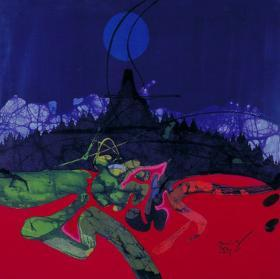

img_ret_number = 106

image_id = P-1173_t
Row, Column_num = 2700,0
Delta Diff= [[69.42191775]]


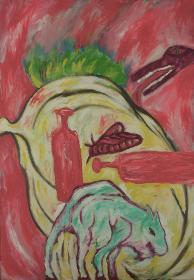

img_ret_number = 107

image_id = P-0566_t
Row, Column_num = 2756,0
Delta Diff= [[38.81481486]]


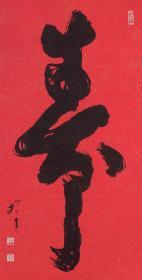

img_ret_number = 108

image_id = 2016-00392_t
Row, Column_num = 2758,0
Delta Diff= [[62.64420542]]


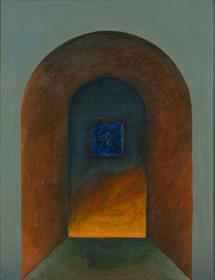

img_ret_number = 109

image_id = 2003-04007_t
Row, Column_num = 2816,0
Delta Diff= [[68.17797737]]


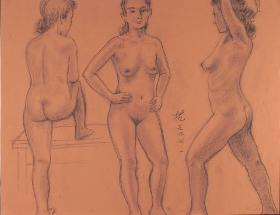

img_ret_number = 110

image_id = P-0233_t
Row, Column_num = 2846,3
Delta Diff= [[54.05023946]]


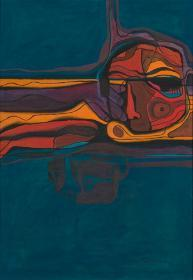

img_ret_number = 111

image_id = 2010-00813_t
Row, Column_num = 2864,4
Delta Diff= [[57.8040911]]


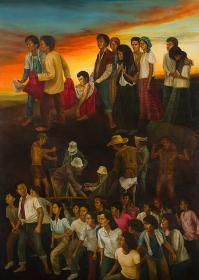

img_ret_number = 112

image_id = 2018-01079_t
Row, Column_num = 2879,3
Delta Diff= [[59.42816273]]


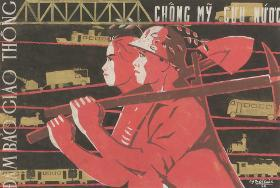

img_ret_number = 113

image_id = 2014-01343_t
Row, Column_num = 2944,1
Delta Diff= [[53.37006769]]


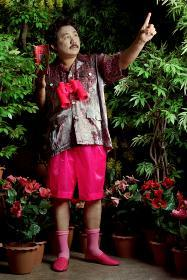

img_ret_number = 114

image_id = 2014-01040_t
Row, Column_num = 3003,2
Delta Diff= [[69.45467288]]


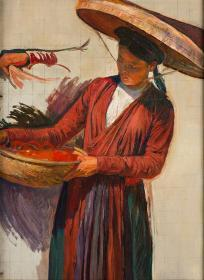

img_ret_number = 115

image_id = P-0191_t
Row, Column_num = 3019,1
Delta Diff= [[51.13851305]]


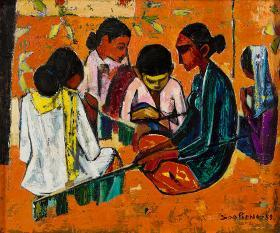

img_ret_number = 116

image_id = 2014-01341_t
Row, Column_num = 3022,1
Delta Diff= [[29.50680831]]


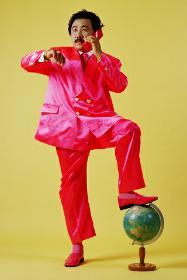

img_ret_number = 117

image_id = P-0957_t
Row, Column_num = 3109,3
Delta Diff= [[68.22739197]]


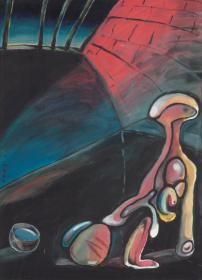

img_ret_number = 118

image_id = 2015-00487_t
Row, Column_num = 3118,0
Delta Diff= [[56.92251369]]


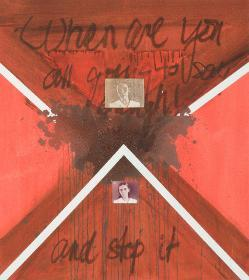

img_ret_number = 119

image_id = P-1215_t
Row, Column_num = 3132,0
Delta Diff= [[44.10455704]]


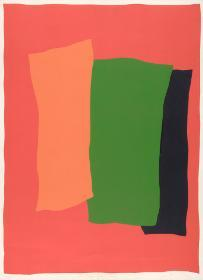

img_ret_number = 120

image_id = 2011-02033_t
Row, Column_num = 3237,3
Delta Diff= [[64.75496386]]


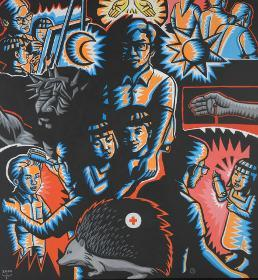

img_ret_number = 121

image_id = 2020-00262_t
Row, Column_num = 3252,1
Delta Diff= [[32.97855801]]


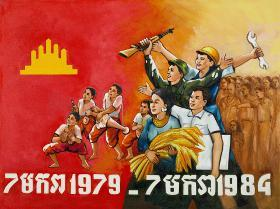

img_ret_number = 122

image_id = P-0778_t
Row, Column_num = 3267,1
Delta Diff= [[65.04790095]]


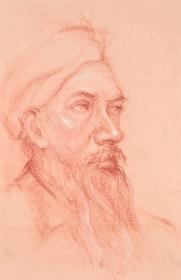

img_ret_number = 123

image_id = GI-0582-(PC)_t
Row, Column_num = 3316,2
Delta Diff= [[58.12338899]]


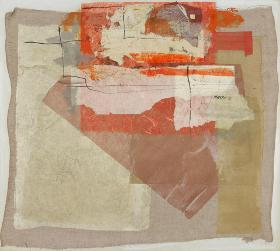

img_ret_number = 124

image_id = P-1076_t
Row, Column_num = 3333,2
Delta Diff= [[48.80947214]]


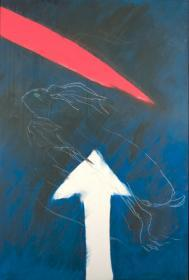

img_ret_number = 125

image_id = P-0076_t
Row, Column_num = 3336,1
Delta Diff= [[67.6355276]]


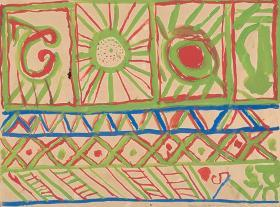

img_ret_number = 126

image_id = 2018-01081_t
Row, Column_num = 3352,1
Delta Diff= [[51.09460663]]


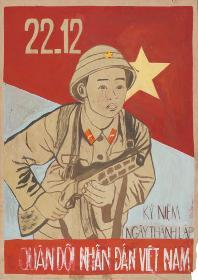

img_ret_number = 127

image_id = 1995-01802_t
Row, Column_num = 3376,2
Delta Diff= [[66.53830191]]


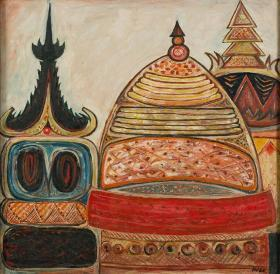

img_ret_number = 128

image_id = 2015-00315_t
Row, Column_num = 3409,1
Delta Diff= [[60.54351422]]


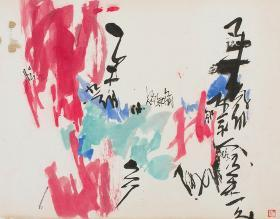

img_ret_number = 129

image_id = P-1212_t
Row, Column_num = 3411,1
Delta Diff= [[68.66680414]]


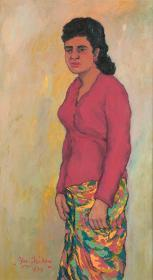

img_ret_number = 130

image_id = P-0092_t
Row, Column_num = 3431,3
Delta Diff= [[56.92776424]]


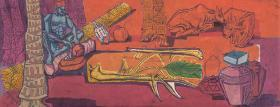

img_ret_number = 131

image_id = P-0354-C_t
Row, Column_num = 3503,3
Delta Diff= [[65.22925713]]


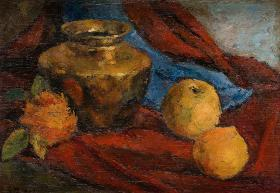

img_ret_number = 132

image_id = 2020-00265_t
Row, Column_num = 3511,2
Delta Diff= [[64.95298637]]


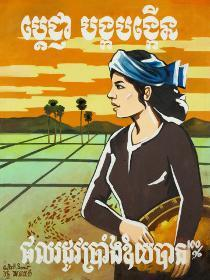

img_ret_number = 133

image_id = GI-0203-(PC)_t
Row, Column_num = 3531,2
Delta Diff= [[38.49604673]]


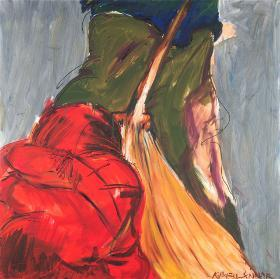

img_ret_number = 134

image_id = P-1028_t
Row, Column_num = 3636,3
Delta Diff= [[63.24771734]]


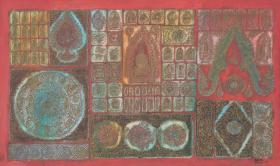

img_ret_number = 135

image_id = 2012-00473_t
Row, Column_num = 3660,2
Delta Diff= [[38.41826839]]


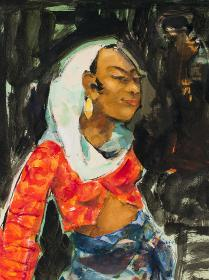

img_ret_number = 136

image_id = 2017-00818_t
Row, Column_num = 3725,1
Delta Diff= [[68.8797217]]


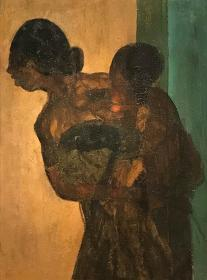

img_ret_number = 137

image_id = P-0952_t
Row, Column_num = 3732,3
Delta Diff= [[54.27231665]]


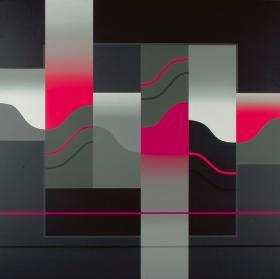

img_ret_number = 138

image_id = 2012-00756_t
Row, Column_num = 3744,2
Delta Diff= [[49.83756021]]


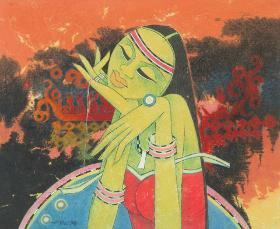

img_ret_number = 139

image_id = 2014-01344_t
Row, Column_num = 3753,2
Delta Diff= [[41.93729508]]


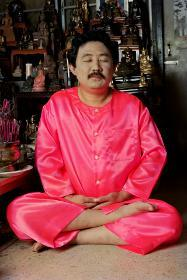

img_ret_number = 140

image_id = P-1194_t
Row, Column_num = 3780,0
Delta Diff= [[67.53452061]]


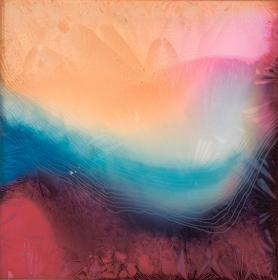

img_ret_number = 141

image_id = 2011-00691_t
Row, Column_num = 3865,1
Delta Diff= [[40.58870255]]


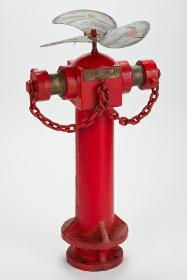

img_ret_number = 142

image_id = P-1035_t
Row, Column_num = 3889,0
Delta Diff= [[67.31843697]]


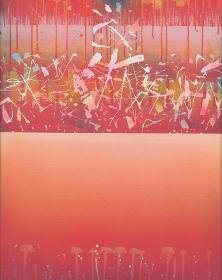

img_ret_number = 143

image_id = P-1190_t
Row, Column_num = 3930,1
Delta Diff= [[66.33977914]]


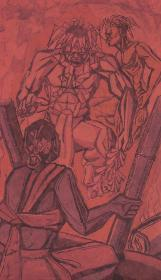

img_ret_number = 144

image_id = 2014-01340_t
Row, Column_num = 3939,3
Delta Diff= [[56.35827445]]


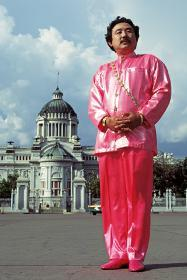

img_ret_number = 145

image_id = 2001-03370_t
Row, Column_num = 3948,4
Delta Diff= [[54.47430843]]


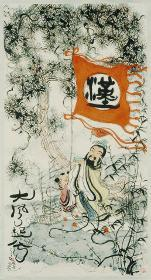

img_ret_number = 146

image_id = 2020-00263_t
Row, Column_num = 3956,2
Delta Diff= [[37.04974252]]


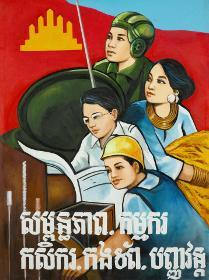

img_ret_number = 147

image_id = 2001-02698_t
Row, Column_num = 3975,3
Delta Diff= [[66.19938861]]


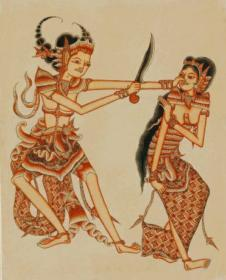

img_ret_number = 148

image_id = 2016-00391_t
Row, Column_num = 3996,2
Delta Diff= [[45.45192093]]


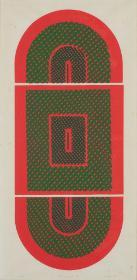

img_ret_number = 149

image_id = P-0558_t
Row, Column_num = 4036,3
Delta Diff= [[69.80461895]]


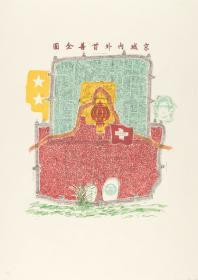

img_ret_number = 150

image_id = P-1232_t
Row, Column_num = 4124,1
Delta Diff= [[32.92916722]]


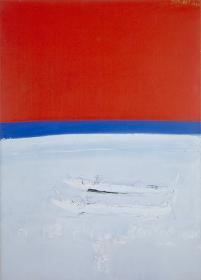

img_ret_number = 151

image_id = 2010-00812_t
Row, Column_num = 4134,1
Delta Diff= [[56.98283807]]


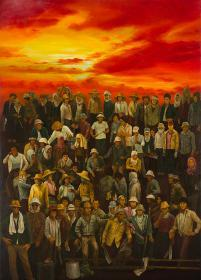

img_ret_number = 152

image_id = 1998-00129_t
Row, Column_num = 4181,0
Delta Diff= [[59.03340608]]


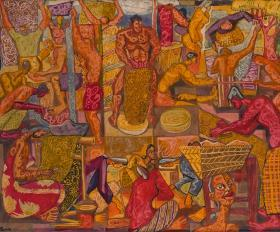

img_ret_number = 153

image_id = 2010-03472_t
Row, Column_num = 4209,1
Delta Diff= [[60.99283777]]


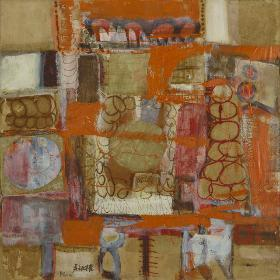

img_ret_number = 154

image_id = 2015-00425_t
Row, Column_num = 4212,0
Delta Diff= [[64.60737858]]


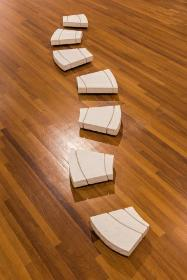

img_ret_number = 155

image_id = P-0336_t
Row, Column_num = 4253,3
Delta Diff= [[69.7233508]]


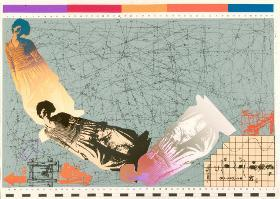

img_ret_number = 156

image_id = 2017-00239_t
Row, Column_num = 4256,1
Delta Diff= [[63.5475174]]


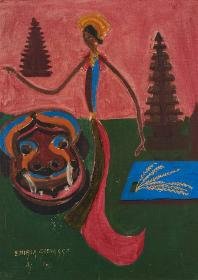

img_ret_number = 157

image_id = 2018-00045_t
Row, Column_num = 4262,2
Delta Diff= [[69.30400985]]


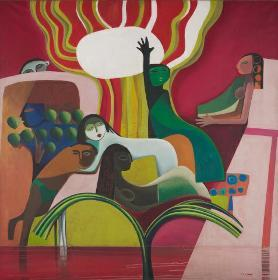

img_ret_number = 158

image_id = P-1293_t
Row, Column_num = 4270,3
Delta Diff= [[67.73492062]]


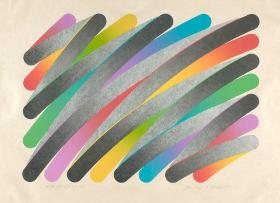

img_ret_number = 159

image_id = 2014-01342_t
Row, Column_num = 4279,2
Delta Diff= [[53.7395775]]


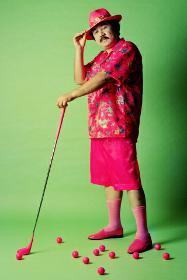

img_ret_number = 160

image_id = P-1192_t
Row, Column_num = 4288,3
Delta Diff= [[60.08604057]]


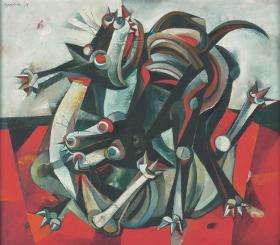

img_ret_number = 161

image_id = 2011-02051_t
Row, Column_num = 4294,3
Delta Diff= [[45.78811118]]


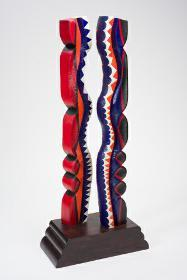

img_ret_number = 162

image_id = 2000-01012_t
Row, Column_num = 4308,0
Delta Diff= [[68.60812849]]


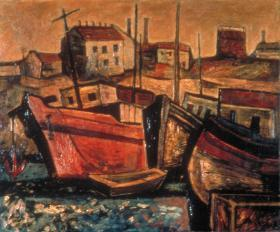

img_ret_number = 163

image_id = GI-0109_t
Row, Column_num = 4325,2
Delta Diff= [[60.98224457]]


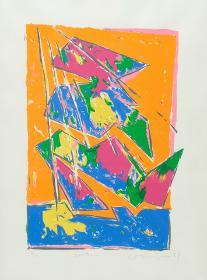

img_ret_number = 164

image_id = P-0152_t
Row, Column_num = 4329,1
Delta Diff= [[68.41691291]]


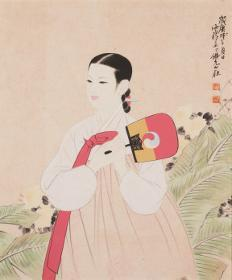

img_ret_number = 165

image_id = P-0117_t
Row, Column_num = 4334,1
Delta Diff= [[59.22447553]]


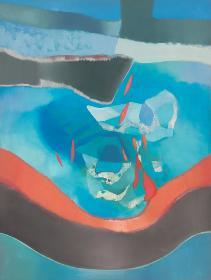

img_ret_number = 166

image_id = 2003-02698 to 2003-02712_t
Row, Column_num = 4354,2
Delta Diff= [[55.33645944]]


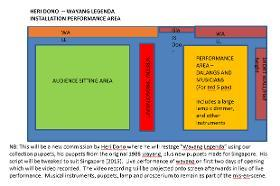

img_ret_number = 167

Total matching images = 167


In [142]:
#TEST call match_image for Test Green
# match_image_by_color(color, threshold, rows_to_chk, columns_to_chk)

match_image_by_color(COLORS['RED'], 70, 4379, 6)

In [39]:
#TEST call match_image for Test 3

# match_image_by_color(COLORS['BLUE'], 135, 4379, 6)

In [744]:
img_colors_df.head()

,id,0,1,2,3,4,5
0,2017-00812_t,#2c373b,#e8eded,#606b70,#0c1415,#9ea6a9,NaN
1,2008-06834_t,#100e0d,#ada090,#807768,#c9bcae,#524d3f,NaN
2,2009-02954_t,#463531,#2b2b29,#80433d,#7a6b5c,#5e443d,NaN
3,2014-01373_t,#c8c8c0,#475449,#8c968c,#afb1a6,#69776e,NaN
4,2014-01336_t,#8f7a60,#2c1b11,#493524,#170e09,#69533a,NaN


In [80]:
##* WORKING acccessing specific cell 

# row = 0
# column = 1 
# feat_col = img_colors_df.loc[row][column]   
# print(f'feat_col = {feat_col}')


In [78]:
##* WORKING acccessing specific cell 

# for row in range(3):
#     row_col = img_colors_df.loc[row][2]   
#     print(f'row_col = {row_col}')

In [79]:
# #* WORKING acccessing specific cell 

# for column in range(3):
#     row_col = img_colors_df.loc[0][column]   
#     print(f'row_col = {row_col}')

In [530]:
type(feat_col)

pandas.core.frame.DataFrame

In [789]:
# feat_col = img_colors_df_copy[["0","1","2","3","4","5"]]
# feat_col=feat_col.values.tolist()
# feat_col

In [81]:
# #* TEST TO LOOP COLUMNS

# def show_column_color(number_of_columns):
#     i = 1
#     #SelectedColorList =pd.DataFrame([])
#     for i in range(number_of_columns):  #chgd image to img
#         curr_column_num = str([i])
#         curr_column_hex = img_colors_df_copy[(curr_column_num)]
        
#         print(curr_column_hex)
#         i+=1

In [791]:
# show_column_color(6)

In [ ]:
# #* USE AS REFERENCE

# def show_numimages_numshades(img, number_of_images, number_of_shades):
#     index = 1
#     SelectedColorList =pd.DataFrame([])
#     for i in range(number_of_images):  #chgd image to img
#         image_colors = extract_image_colors(img[i],
#                             number_of_images,
#                             number_of_shades,
#                             show_image
#                             )
#         dfList = pd.concat([dfList, image_colors])
#         #    images.append(get_image(os.path.join(IMAGE_DIRECTORY, file)))
#         if show_image == True:
#             plt.figure(figsize = (10, 5))
#             plt.subplot(1, number_of_images, index)
#             plt.imshow(img[i])  #chgd image to img
#         index += 1
#         dfList.reset_index(drop=True, inplace=True)
        
#     return dfList

In [501]:
# TEST 2 call match_image for above

match_image_by_color(COLORS['BLUE'], 65, 6)

selected_color_name = [0, 0, 255]
selected_color_lab= [[[  32.29567257   79.18559091 -107.85730021]]]
row num = 0
column_num = 0
column_hexcolor = #2c373b
(44, 55, 59)
[[[22.24377257 -3.49335741 -4.0200887 ]]]
column_LABcolor = [[[22.24377257 -3.49335741 -4.0200887 ]]]
diff= [[133.11279308]]
False


False

In [ ]:
# for column in df_10k:
#     for values in df_10k[column].values:
#         #test_5[dataFrame['column name'].str.match('#')]
#         if str(values).startswith('#'):
#             hex_to_rgb = ImageColor.getrgb(values)
#             print(hex_to_rgb)

In [670]:
# #* WORKING TO HARDCODE INPUT HEX CODES HERE
# def get_color_by_column(img_color_column_num):
#     column_hexcolor = '#4169E1'
#     return column_hexcolor

In [82]:
# #* WORKING TO CALL HARDCODE INPUT HEX CODES HERE
# get_color_by_column(1)

In [398]:
#* WORKING loop to iterate over columns in df
# for column in img_colors_df:
#     for values in img_colors_df[column].values:
#         if str(values).startswith('#'):
#             print(values)
# return(values)
            

In [350]:
#* WORKING LOOP RETRIEVE COLOR HEXCODES from DF

# for column in img_colors_df:
#     for values in img_colors_df[column].values:
#         #test_5[dataFrame['column name'].str.match('#')]
#         if str(values).startswith('#'):
#             print(values)

In [34]:
hex2lab('#008B8B')

(0, 139, 139)
[[[ 52.20546966 -30.62216978  -8.99508228]]]


array([[[ 52.20546966, -30.62216978,  -8.99508228]]])

In [ ]:
#**** WRITE CODE TO LOOP THRU DF to and call match_image_colors
#step 1: select acc_ID if match
#step 2: show image by acc ID

def show_selected_images(img, color, threshold, colors_to_match): #chgd images to img
    index = 1
    
    for i in range(len(img)):  #chgd image to img
        selected = match_image_by_color(img[i],  #chgd image to img
                                        color,
                                        threshold,
                                        colors_to_match)
        if (selected):
            #plt.subplot(1, 5, index) #* test chg column to return number per selected img[i]below 
            plt.subplot(1, 62, index)
            plt.imshow(img[i])  #chgd image to img
            index += 1

In [33]:
# for (colname,colval) in workbook.iteritems():
#     print(colname, colval.values)

In [21]:
# #* sample test code
# from matplotlib import cm
# n_colors = 10
# colours = cm.rainbow(np.linspace(0, 1, n_colors))

In [28]:
# #***Check*** Alternative method. Sample code to generate color range in python output hex values
# # check if meets objective of creating a set range of hex values per color?
# # https://stackoverflow.com/questions/876853/generating-color-ranges-in-python
# # import colorsys

# def get_N_HexCol(N=5):
#     HSV_tuples = [(x * 1.0 / N, 0.5, 0.5) for x in range(N)]
#     hex_out = []
#     for rgb in HSV_tuples:
#         rgb = map(lambda x: int(x * 255), colorsys.hsv_to_rgb(*rgb))
#         hex_out.append('#%02x%02x%02x' % tuple(rgb))
#     return hex_out

In [29]:
# #***Check*** Sample code to generate color range in python output hex values
# get_N_HexCol(N=5)

['#7f3f3f', '#727f3f', '#3f7f59', '#3f597f', '#723f7f']

In [129]:
def show_selected_images(img, color, threshold, colors_to_match): #chgd images to img
    index = 1
    
    for i in range(len(img)):  #chgd image to img
        selected = match_image_by_color(img[i],  #chgd image to img
                                        color,
                                        threshold,
                                        colors_to_match)
        if (selected):
            #plt.subplot(1, 5, index) #* test chg column to return number per selected img[i]below 
            plt.subplot(1, 62, index)
            plt.imshow(img[i])  #chgd image to img
            index += 1

CPU times: user 1e+03 ns, sys: 1 µs, total: 2 µs
Wall time: 3.1 µs


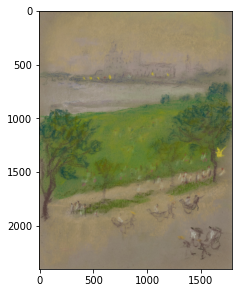

In [94]:
#* Search for GREEN (range set)
%time
plt.figure(figsize = (20, 10))
show_selected_images(img, COLORS['GREEN'], 60, 1)  #chgd image to img

In [118]:
#* Search for GREEN (range set - test max threshold (split part A))
%time
plt.figure(figsize = (20, 10))


CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 3.1 µs


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

In [ ]:
#* Search for GREEN (range set - test max threshold(split part B))

show_selected_images(img, COLORS['GREEN'], 60, 20)  #chgd image to img
%time

CPU times: user 1e+03 ns, sys: 1 µs, total: 2 µs
Wall time: 3.81 µs


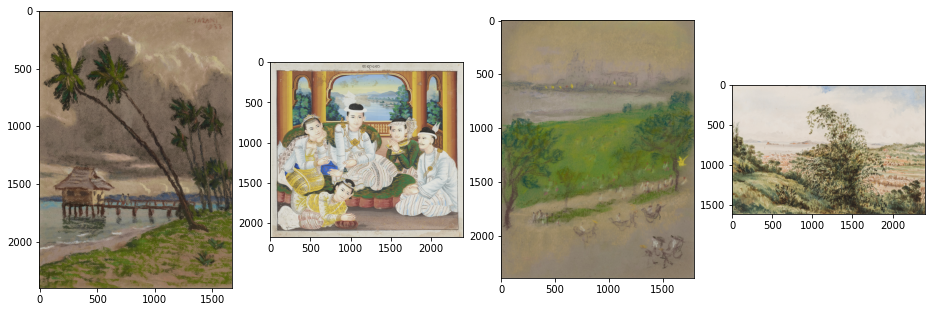

In [99]:
# Search for GREEN
%time
plt.figure(figsize = (20, 10))
show_selected_images(img, COLORS['GREEN'], 60, 5)  #chgd image to img, updated number of colors

In [84]:
# #* Search for GREEN (full set - max threshold)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['GREEN'], 100, 5)  

In [85]:
# #* Search for GREEN (full set - higher color return 20)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['GREEN'], 60, 20)  

In [86]:
# #* Search for GREEN (full set - higher color return 10)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['GREEN'], 60, 10)  

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.91 µs


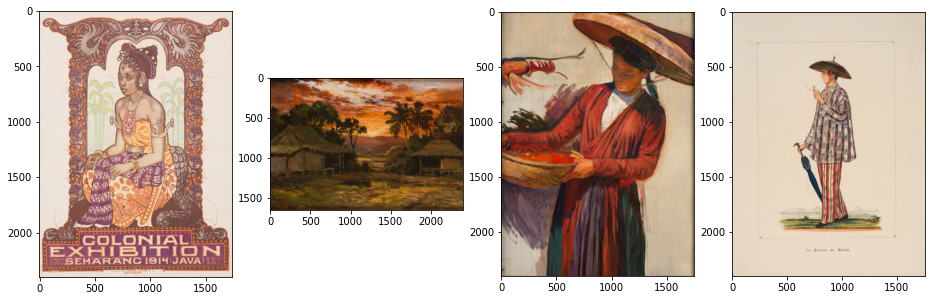

In [100]:
# Search for RED (full set)
%time
plt.figure(figsize = (20, 10))
show_selected_images(images, COLORS['RED'], 60, 5)

In [87]:
# #* Search for RED (full set - higher color return 20)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['RED'], 60, 20)

In [88]:
# #* Search for RED (full set - max threshold)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['RED'], 100, 5)

In [90]:
# #* Search for RED (full set - higher color return 10)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['RED'], 60, 10)

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 1.91 µs


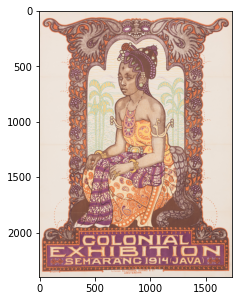

In [102]:
#* Search for RED (range set)
%time
plt.figure(figsize = (20, 10))
show_selected_images(img, COLORS['RED'], 60, 5)

In [91]:
# #* Search for RED (range set - higher color return)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(img, COLORS['RED'], 60, 20)

In [92]:
# #* Search for BLUE (range set)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(img, COLORS['BLUE'], 60, 5)

In [93]:
# # Search for BLUE (full set)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['BLUE'], 60, 5)

In [94]:
# # Search for BLUE (full set - max threshold)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['BLUE'], 100, 5)

In [95]:
# # Search for BLUE (full set - higher color return)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['BLUE'], 60, 20)

In [96]:
# # Search for BLUE (full set - higher color return)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['BLUE'], 60, 10)

In [97]:
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['YELLOW'], 60, 1)

In [98]:
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['YELLOW'], 60, 3)

In [99]:
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['GREEN'], 60, 3)

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 1.91 µs


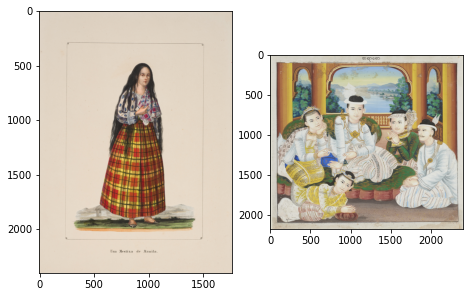

In [106]:
#* Search for YELLOW (range set)
%time
plt.figure(figsize = (20, 10))
show_selected_images(img, COLORS['YELLOW'], 60, 10)

CPU times: user 1 µs, sys: 0 ns, total: 1 µs
Wall time: 5.96 µs


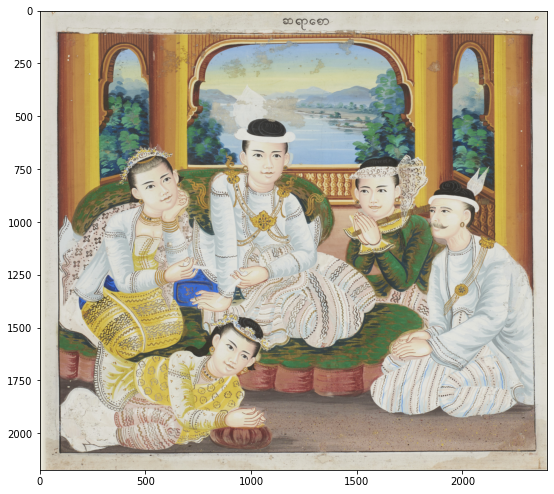

In [122]:
#* Search for YELLOW (range set - higher color return)
%time
plt.figure(figsize = (20, 10))
show_selected_images(img, COLORS['YELLOW'], 60, 20)

In [100]:
# #* Search for YELLOW (full set - higher color return)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['YELLOW'], 60, 20)

In [101]:
# #* Search for YELLOW (full set - max threshold)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['YELLOW'], 100, 5)

In [102]:
# #* Search for YELLOW (full set - higher color return 10)
# %time
# plt.figure(figsize = (20, 10))
# show_selected_images(images, COLORS['YELLOW'], 60, 10)

# Alternative search side rainbow dictionary 

In [ ]:
# #* RAINBOW COLOR DICTIONARY REFERENCE

# COLORS = {
#     'VIOLET': [148, 0, 211], #Hex #9400D3
#     'INDIGO': [75, 0, 130], #Hex #4B0082
#     'BLUE': [0, 0, 255],  # Hex #0000FF THRESHOLD [70?]
#     'GREEN': [0, 128, 0], # Hex #008000, THRESHOLD [65]
#     'YELLOW': [255, 255, 0], # Hex #FFFF00
#     'ORANGE': [255, 127, 0], # Hex #FF7F00
#     'RED': [255, 0, 0] # Hex #FF0000
# }

In [70]:
sns.color_palette("Blues", 10, as_cmap=False)


[(0.8978854286812764, 0.939038831218762, 0.977362552864283),
 (0.828881199538639, 0.8937639369473279, 0.954725105728566),
 (0.7506343713956171, 0.8478431372549019, 0.9282122260668974),
 (0.6325259515570935, 0.7976470588235294, 0.8868742791234141),
 (0.491764705882353, 0.7219684736639754, 0.8547789311803152),
 (0.36159938485198, 0.6427374086889658, 0.8165782391387928),
 (0.24816608996539793, 0.5618915801614763, 0.7709803921568628),
 (0.15072664359861593, 0.4644521337946943, 0.7207843137254902),
 (0.07481737793156479, 0.3732564398308343, 0.6552095347943099),
 (0.03137254901960784, 0.28161476355247983, 0.5582622068435218)]

In [72]:
import matplotlib as mpl

rgb_colors = sns.color_palette('Blues', 10, as_cmap=False)
rgb_colors

[(0.8978854286812764, 0.939038831218762, 0.977362552864283),
 (0.828881199538639, 0.8937639369473279, 0.954725105728566),
 (0.7506343713956171, 0.8478431372549019, 0.9282122260668974),
 (0.6325259515570935, 0.7976470588235294, 0.8868742791234141),
 (0.491764705882353, 0.7219684736639754, 0.8547789311803152),
 (0.36159938485198, 0.6427374086889658, 0.8165782391387928),
 (0.24816608996539793, 0.5618915801614763, 0.7709803921568628),
 (0.15072664359861593, 0.4644521337946943, 0.7207843137254902),
 (0.07481737793156479, 0.3732564398308343, 0.6552095347943099),
 (0.03137254901960784, 0.28161476355247983, 0.5582622068435218)]

In [63]:
hex_colors = list(map(mpl.colors.rgb2hex, rgb_colors))
hex_colors

['#fee6da',
 '#fdd0bc',
 '#fcb499',
 '#fc9576',
 '#fb7858',
 '#f7593f',
 '#ec382b',
 '#d11e1f',
 '#b61319',
 '#940b13']

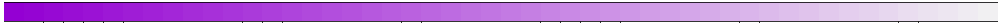

In [59]:
# Seaborn custom sequential palettes
# Parameters: 
# color – HEX code, HTML color name of the chosen color 
# reverse – If True, the order of colours is reversed 
# as_cmap – If True, return a matplotlib colormap instead of a list of colors 
# input – color space to which color values refer : {‘rgb’, ‘hls’, ‘husl’, xkcd’}

violet_range = sns.palplot(sns.light_palette(color='#9400D3',n_colors=50,reverse=True,as_cmap=False,input='rgb'))
# violet_range_hex = list(map(mpl.colors.rgb2hex, violet_range))

In [43]:
violet_range_hex = list(map(mpl.colors.rgb2hex, violet_range))

TypeError: 'NoneType' object is not iterable